<img src = "https://previews.123rf.com/images/marylia17/marylia171904/marylia17190400034/124094278-vector-set-of-hand-drawn-doodle-clouds-rainy-day-weather-forecast.jpg"  align = center>

<h1 align=center><font size = 5> Rain Forecast in AUS </font></h1>


# Business Problems

Weather forecast have been helpful for entire city and country to predict whether will rain or not for tomorrow, a week and maybe a month. We would like to make a Prediction model that can predict rain in a day forward. 

Lets first import required libraries and function from rain_module.py :

In [1]:
from rain_module import *

# Data Story

Observations were drawn from numerous weather stations. The daily observations are available from http://www.bom.gov.au/climate/data. Copyright Commonwealth of Australia 2010, Bureau of Meteorology. 

This dataset contains daily weather observations from numerous Australian weather stations.

The target variable RainTomorrow means: Did it rain the next day? Yes or No.

Note: We should exclude the variable Risk-MM when training a binary classification model. Not excluding it will leak the answers to your model and reduce its predictability.

Load the csv data from our library

In [2]:
fr = forecast_rain()
df = fr.load_data('weatherAUS.csv')
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0.0,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,1.0,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0.2,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142188,2017-06-20,Uluru,3.5,21.8,0.0,NaN,NaN,E,31.0,ESE,...,27.0,1024.7,1021.2,NaN,NaN,9.4,20.9,No,0.0,No
142189,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,0.0,No
142190,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,0.0,No
142191,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,0.0,No


# Data Pre-Processing

Let's check if there are missing values in the data set. and analyze the features we want to select and use in the modelling process.

In [3]:
missval = fr.nulled_value(df)

for missing value in int or float type, we replace the nan value with mean value for each columns. Why dont we drop all the nan value, because the number of nan value is huge, more than 50% of the data will be lost if we remove it. For missing value in object type, we drop the row that contain nan value.

Let's we drop the 'Date' feature since it can't be used for modeling, but before we remove we will transform 'Date' Feature into 'Days' and 'Month' Feature. and also, we drop the 'RISK_MM' feature

In [4]:
df_clean = fr.clean(df)
df_clean

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month
0,Albury,13.4,22.9,0.6,5.469824,7.624853,W,44.0,W,WNW,...,1007.7,1007.1,8.000000,4.503167,16.9,21.8,No,No,1,12
1,Albury,7.4,25.1,0.0,5.469824,7.624853,WNW,44.0,NNW,WSW,...,1010.6,1007.8,4.437189,4.503167,17.2,24.3,No,No,2,12
2,Albury,12.9,25.7,0.0,5.469824,7.624853,WSW,46.0,W,WSW,...,1007.6,1008.7,4.437189,2.000000,21.0,23.2,No,No,3,12
3,Albury,9.2,28.0,0.0,5.469824,7.624853,NE,24.0,SE,E,...,1017.6,1012.8,4.437189,4.503167,18.1,26.5,No,No,4,12
4,Albury,17.5,32.3,1.0,5.469824,7.624853,W,41.0,ENE,NW,...,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No,5,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142188,Uluru,3.5,21.8,0.0,5.469824,7.624853,E,31.0,ESE,E,...,1024.7,1021.2,4.437189,4.503167,9.4,20.9,No,No,20,6
142189,Uluru,2.8,23.4,0.0,5.469824,7.624853,E,31.0,SE,ENE,...,1024.6,1020.3,4.437189,4.503167,10.1,22.4,No,No,21,6
142190,Uluru,3.6,25.3,0.0,5.469824,7.624853,NNW,22.0,SE,N,...,1023.5,1019.1,4.437189,4.503167,10.9,24.5,No,No,22,6
142191,Uluru,5.4,26.9,0.0,5.469824,7.624853,N,37.0,SE,WNW,...,1021.0,1016.8,4.437189,4.503167,12.5,26.1,No,No,23,6


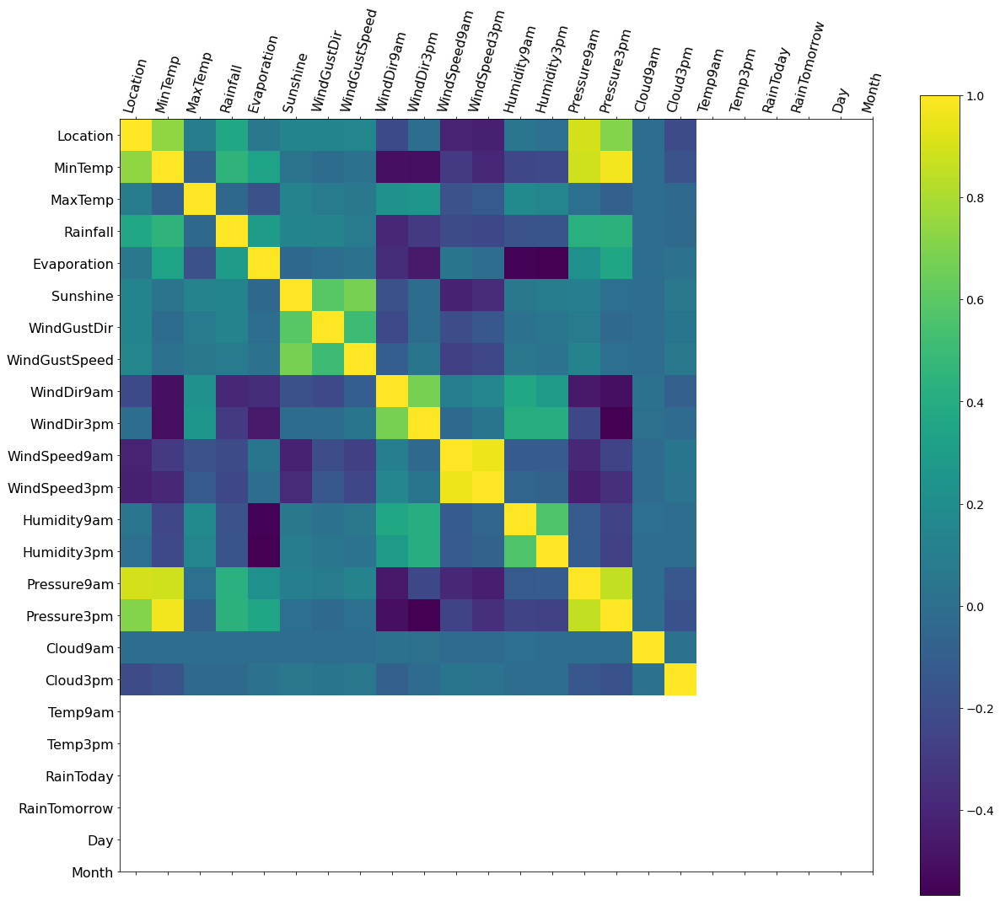

In [5]:
fig = plt.figure(figsize=(20, 17))
plt.matshow(df_clean.corr(),fignum=fig.number)
plt.xticks(range(df_clean.shape[1]),df_clean.columns,fontsize=16,rotation=75)
plt.yticks(range(df_clean.shape[1]),df_clean.columns,fontsize=16)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)

As you can see the location, day and month doesnt have explicit correlation for each columns, so we better get rid off it.

In [6]:
df_clean.drop(columns={'Location','Day','Month'},inplace=True)

Let's Check the outliers of dataset, below we can see there's plenty outliers in the data set and if we remove them all we would lose most of information of the data set

<AxesSubplot:>

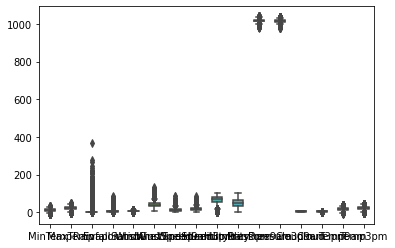

In [7]:
sns.boxplot(data=df_clean,width=0.5,)

<AxesSubplot:xlabel='RainTomorrow', ylabel='Rainfall'>

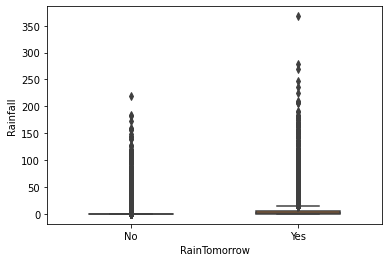

In [8]:
sns.boxplot(data=df_clean, x=df_clean['RainTomorrow'],y=df_clean['Rainfall'], width=0.5)

<AxesSubplot:xlabel='RainTomorrow', ylabel='Evaporation'>

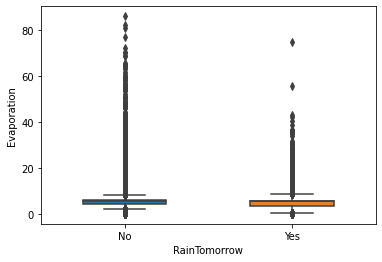

In [9]:
sns.boxplot(data=df_clean, x=df_clean['RainTomorrow'],y=df_clean['Evaporation'],width=0.5)

<AxesSubplot:xlabel='RainTomorrow', ylabel='Sunshine'>

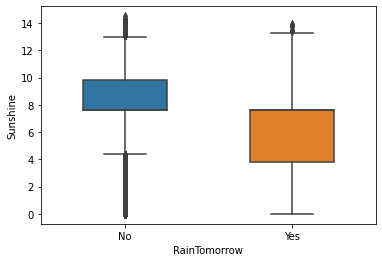

In [10]:
sns.boxplot(data=df_clean, x=df_clean['RainTomorrow'],y=df_clean['Sunshine'], width=0.5,)

<AxesSubplot:xlabel='RainTomorrow', ylabel='WindGustSpeed'>

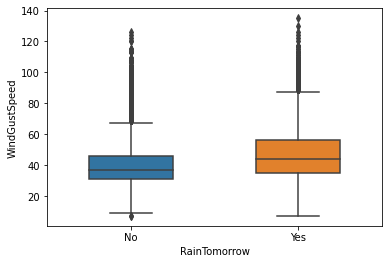

In [11]:
sns.boxplot(data=df_clean, x=df_clean['RainTomorrow'],y=df_clean['WindGustSpeed'], width=0.5,)

So, what i am going to do is i would remove the outlier which have zscore > 3. (which mean i would remove outlier which value is 3 times from it's standard deviation after minus i'ts mean.

In [12]:
df_clean2 = fr.remove_outliers(df_clean)

We have remove 7197 outliers


# Modeling with Logistic Regression

Logistic Regression is a variation of Linear Regression, useful when the observed dependent variable, y, is categorical. It produces a formula that predicts the probability of the class label as a function of the independent variables.

Set x the independent variables which contains all of new_data features except Rain Tommorow as arrays. set Rain Tommorow as Y and transform it inot arrays.

In [13]:
fr.modeling(df_clean2)
y_test = fr.y_real
y_pred = fr.yhat

              precision    recall  f1-score   support

           0       0.87      0.95      0.91     27693
           1       0.72      0.47      0.57      7261

    accuracy                           0.85     34954
   macro avg       0.80      0.71      0.74     34954
weighted avg       0.84      0.85      0.84     34954

Your model have accuracy of : 85.14333123533787 %


Based on the count of each section, we can calculate precision and recall of each label:


- __Precision__ is a measure of the accuracy provided that a class label has been predicted. It is defined by: precision = TP / (TP + FP)

- __Recall__ is true positive rate. It is defined as: Recall =  TP / (TP + FN)

    
So, we can calculate precision and recall of each class.

__F1 score:__
Now we are in the position to calculate the F1 scores for each label based on the precision and recall of that label. 

The F1score is the harmonic average of the precision and recall, where an F1 score reaches its best value at 1 (perfect precision and recall) and worst at 0. It is a good way to show that a classifer has a good value for both recall and precision.


And finally, we can tell the average accuracy for this classifier is the average of the f1-score for both labels, which is 0.95 in our case.

# Evaluation 

## Confusion Matrix

for double evaluation we will make confusion matrix. confusion matrix will compare the true value and predicted value of each prediction. 

Normalized confusion matrix
[[0.95157621 0.04842379]
 [0.53050544 0.46949456]]


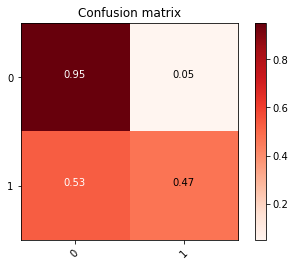

In [16]:
from sklearn.metrics import confusion_matrix
classes = [0,1]
cm = confusion_matrix(y_test, y_pred, labels= classes)
fr.plot_confusion_matrix(cm, classes, normalize= True)

From the confusion matrix, in the first column of x axis, the model we made correctly predict 27362 data as label 0 (which is Tommorow will not Rain) and wrongly predict 4063 Data as label 1 (which is Tommorow will Rain).  In the second column of x axis, the model we made correctly predict 4122 data as label 1 (which is Tommorow will Rain) and wrongly predict 1566 Data as label 0 (which is Tommorow will not Rain)